## Cancer Prediction with Python

In [11]:
import pandas as pd
import seaborn as sns

In [12]:
data = pd.read_csv("../data/breast_cancer.csv")
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [14]:
data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


### clean

Fajnym sposobem na sprawdzenie NA jest heatmapa:

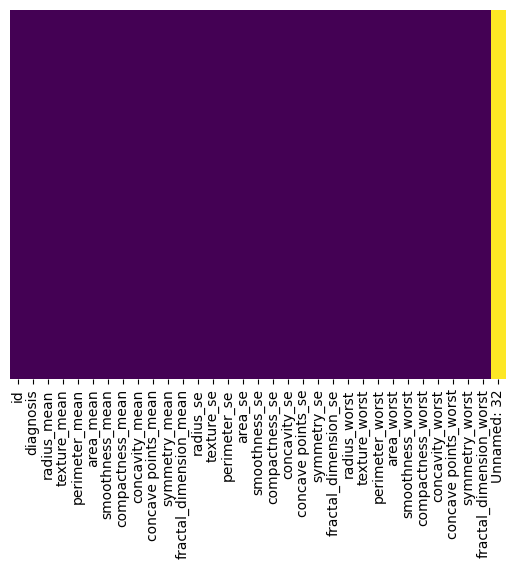

In [10]:
# visualize NAs in heatmap
sns.heatmap(data.isnull(), yticklabels=False, cbar=False, cmap='viridis');

In [ ]:
# drop id and empty column
# Kolumny 'Unnamed: 32' i 'id' zostaną usunięte bezpośrednio z obiektu data, a nie zostanie zwrócona nowa zmodyfikowana wersja tego DataFrame.
# axis=1 oznacza, że usuwamy kolumny, a 0, że usuwamy wiersze.
data.drop(['Unnamed: 32', "id"], axis=1, inplace=True)

In [ ]:
# Zamienia zmienną celu (kolumnę 'diagnosis') na wartości binarne 1 i 0
# Jeśli wartość wynosi "M" (Malignant), przypisuje 1, inaczej przypisuje 0
# Dzięki temu przekształcamy zmienną kategoryczną na numeryczną, co jest przydatne do analizy lub modelowania

data.diagnosis = [1 if value == "M" else 0 for value in data.diagnosis]

In [18]:
# turn the target variable into categorical data
data['diagnosis'] = data['diagnosis'].astype('category',copy=False)

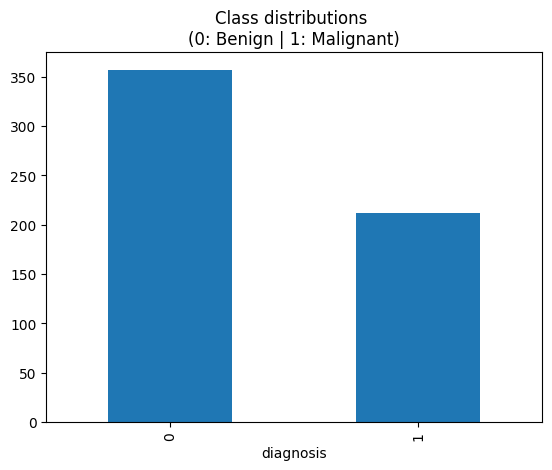

In [19]:
plot = data['diagnosis'].value_counts().plot(kind='bar', title="Class distributions \n(0: Benign | 1: Malignant)")
fig = plot.get_figure()

In [20]:
# Wywołujemy funkcję `pairplot` z Seaborn, aby stworzyć wykresy par zmiennych w zbiorze danych.
sns.pairplot(data,
             # Określamy zbiór danych, który chcemy zwizualizować. 
             kind='scatter', 
             # Ustawiamy `kind` na 'scatter', co oznacza, że na wykresie parowym będą użyte wykresy punktowe.
             plot_kws={'alpha':0.4}, 
             # Przekazujemy argument `plot_kws`, czyli parametry dla każdego wykresu punktowego.
             # `alpha` kontroluje przezroczystość punktów, ustawiamy ją na 0.4, co zmniejsza widoczność nakładających się punktów.
             diag_kws={'alpha':0.55, 'bins':40})

### Kiedy trenować model na **wszystkich zmiennych**?

1. **Modele o wysokiej odporności na szum**: Algorytmy takie jak **las losowy (random forest)** i **drzewa decyzyjne** radzą sobie dobrze z dużą liczbą zmiennych i są mniej podatne na szum. Mogą automatycznie wyodrębniać istotne cechy z całego zestawu zmiennych, dlatego w tych przypadkach można bezpiecznie użyć wszystkich dostępnych zmiennych.
   
2. **Duże zbiory danych**: Kiedy dysponujesz dużą liczbą próbek, modele mają szansę „nauczyć się” istotnych zależności, nawet jeśli niektóre zmienne są mniej istotne. Więcej danych pozwala modelowi zidentyfikować najważniejsze zmienne bez ryzyka przeuczenia (overfitting).

3. **Eksploracja nowych danych**: Jeśli nie masz wcześniejszej wiedzy na temat ważności zmiennych, warto na początku przetestować model na wszystkich zmiennych, aby później określić, które są naprawdę istotne.

### Kiedy wybrać **mniej zmiennych**?

1. **Modele wrażliwe na liczbę zmiennych**: Algorytmy takie jak **regresja liniowa**, **regresja logistyczna** czy **k najbliższych sąsiadów (k-NN)** mogą cierpieć z powodu zbyt dużej liczby zmiennych, szczególnie jeśli niektóre z nich są mało istotne lub wprowadzają szum. Duża liczba zmiennych zwiększa ryzyko przeuczenia, szczególnie przy mniejszych zbiorach danych.

2. **Redukcja szumu i kolinearności**: Nadmiarowe lub skorelowane zmienne (kolinearność) mogą prowadzić do problemów w interpretacji modelu i wpływać na dokładność, zwłaszcza w regresji liniowej. W takich przypadkach warto rozważyć selekcję zmiennych, np. przez metody takie jak **analiza korelacji**, **selekcja oparta na ważności cech (feature importance)** lub **analiza głównych składowych (PCA)**.

3. **Ograniczenia obliczeniowe**: Większa liczba zmiennych zwiększa koszt obliczeniowy modelu. Jeśli pracujesz na dużych zbiorach danych lub ograniczonych zasobach obliczeniowych, wybór mniejszej liczby najistotniejszych zmiennych może poprawić wydajność treningu modelu.

4. **Interpretowalność modelu**: Jeśli ważne jest, aby model był łatwy do zinterpretowania (np. w zastosowaniach medycznych), lepiej skupić się na kilku najistotniejszych zmiennych, ponieważ łatwiej jest wtedy wyjaśnić wyniki modelu.

### Jak wybrać zmienne?

Istnieje kilka metod selekcji zmiennych:

- **Feature Importance**: W przypadku modeli takich jak lasy losowe możesz sprawdzić, które zmienne mają największe znaczenie i wybrać te o najwyższej istotności.
- **Analiza korelacji**: Usunięcie wysoce skorelowanych zmiennych może zmniejszyć redundancję.
- **Metody statystyczne**: Testy statystyczne, takie jak test chi-kwadrat dla zmiennych kategorycznych, mogą pomóc wybrać istotne zmienne.
- **Metody automatycznej selekcji (np. RFE)**: Recursive Feature Elimination (RFE) lub inne techniki selekcji cech pomagają automatycznie wybrać najistotniejsze zmienne dla modelu.

In [21]:
# Prepare the model
y = data["diagnosis"] # our target variable
X = data.drop(["diagnosis"], axis=1) # our predictors

#### Warto teraz **znormalizować** dane - co to jest i po co nam to potrzebne? 

Możesz ulec pokusie, aby użyć tych danych do bezpośredniego podziału treningu na testy. Ale zaraz! Dane nie są jeszcze znormalizowane. Może to stanowić problem, ponieważ jednostki naszych zmiennych niekoniecznie są w tych samych jednostkach. Ponadto mogą istnieć pewne wartości odstające, które mogą spowodować, że nasz model będzie działał źle.

W takich przypadkach normalizujemy dane przed wprowadzeniem ich do naszego modelu. Poprawi to wydajność naszego algorytmu uczenia maszynowego.

In [24]:
from sklearn.preprocessing import StandardScaler

# Create a scaler object
scaler = StandardScaler()

# Fit the scaler to the data and transform the data
X_scaled = scaler.fit_transform(X)

# X_scaled is now a numpy array with normalized data

Następnie dzielimy zbiór danych na zbiór treningowy i zbiór testowy. Oba zestawy mają te same zmienne (kolumny), ale różne obserwacje (wiersze). Do tego celu używamy bardzo wygodnej funkcji Scikit-Learn o nazwie `train_test_split`. Funkcja ta przyjmuje nasze zmienne predykcyjne (predictors) oraz zmienną docelową (target variable) i losowo dzieli je na zbiór treningowy oraz testowy. Zwraca cztery wartości:

- Predyktory zbioru treningowego, które zapisujemy w zmiennej Pythona o nazwie `X_train`.
- Zmienne docelowe zbioru treningowego, które zapisujemy w zmiennej `y_train`.
- Predyktory zbioru testowego, które zapisujemy w zmiennej `X_test`.
- Zmienne docelowe zbioru testowego, które zapisujemy w zmiennej `y_test`.

Każda obserwacja (wiersz) w `X` odpowiada wartości docelowej w `y`.

Funkcja `train_test_split` przyjmuje również inne parametry, takie jak `test_size` i `random_state`:

- `test_size` określa rozmiar naszych `X_test` i odpowiadającego mu `y_test`.
- `random_state` to dowolna liczba całkowita, która pozwala nam na powtórzenie tego samego podziału, jeśli kiedykolwiek będziemy musieli uzyskać dokładnie ten sam, losowy podział danych. Zazwyczaj wybieramy liczbę 42, ponieważ jest to odpowiedź na wszystko.

In [25]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.30, random_state=42)

In [26]:
from sklearn.linear_model import LogisticRegression

# Create logistic regression model
lr = LogisticRegression()

# Train the model on the training data
lr.fit(X_train, y_train)

# Predict the target variable on the test data
y_pred = lr.predict(X_test)

**Ewaluacja modelu**

W tym notatniku wytrenowaliśmy model regresji logistycznej, aby przewidywał zmienną docelową przy użyciu zbioru danych z cechami wejściowymi. 

Jak widzisz, po przeszkoleniu modelu na zbiorze treningowym i ocenie jego wydajności na zbiorze testowym, uzyskaliśmy końcową dokładność wynoszącą 0,98. Jest to bardzo dobry wynik, co oznacza, że model potrafi trafnie przewidywać wyniki dla nowych, wcześniej nieznanych danych.

Warto jednak zauważyć, że dokładność to tylko jeden ze wskaźników wydajności modelu i może nie być najbardziej odpowiednim miarą dla wszystkich problemów. W zależności od problemu i specyficznych wymagań aplikacji, inne miary, takie jak precyzja (precision), czułość (recall) lub F1-score mogą być bardziej istotne. W drugiej komórce używamy funkcji `classification_report` z biblioteki Scikit-Learn do obliczenia tych miar.

In [27]:
from sklearn.metrics import accuracy_score

# Evaluate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.98


In [28]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.99      0.98      0.99       108
           1       0.97      0.98      0.98        63

    accuracy                           0.98       171
   macro avg       0.98      0.98      0.98       171
weighted avg       0.98      0.98      0.98       171



Funkcja `classification_report` z biblioteki Scikit-Learn generuje szczegółowy raport dotyczący wyników klasyfikacji, który zawiera takie miary jak **precyzja (precision)**, **czułość (recall)**, **F1-score** oraz **dokładność (accuracy)** dla każdej z klas. Oto, co oznaczają poszczególne miary:

1. **Precision (Precyzja)**:
   - Precyzja informuje, jaka część przewidywań pozytywnych (np. klasy 1) faktycznie była poprawna.
   - Wzór: \( \text{precision} = \frac{\text{True Positives (TP)}}{\text{True Positives (TP)} + \text{False Positives (FP)}} \)
   - Precyzja jest szczególnie istotna, gdy chcemy uniknąć fałszywych alarmów (false positives).

2. **Recall (Czułość)**:
   - Czułość pokazuje, jak dobrze model wykrywa prawdziwe pozytywne przypadki (np. prawdziwe pozytywne klasy).
   - Wzór: \( \text{recall} = \frac{\text{True Positives (TP)}}{\text{True Positives (TP)} + \text{False Negatives (FN)}} \)
   - Czułość jest istotna, gdy zależy nam, aby wykryć jak najwięcej przypadków danej klasy, nawet jeśli może to spowodować pewną liczbę fałszywych alarmów.

3. **F1-score**:
   - F1-score jest średnią harmoniczną precyzji i czułości, co pozwala na zbalansowanie obu tych miar. Jest przydatny, gdy chcemy znaleźć równowagę między precyzją a czułością.
   - Wzór: \( \text{F1-score} = 2 \times \frac{\text{precision} \times \text{recall}}{\text{precision} + \text{recall}} \)
   - F1-score jest szczególnie użyteczny, gdy mamy niezrównoważony zbiór danych, ponieważ daje miarę, która uwzględnia zarówno fałszywe pozytywy, jak i fałszywe negatywy.

4. **Support (Wsparcie)**:
   - Liczba prawdziwych wystąpień każdej klasy w zbiorze testowym. Pokazuje, ile przypadków z danej klasy było dostępnych do oceny.
